In [1]:
import numpy as np
import pandas as pd
import sys
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
import plotly
import plotly.offline as py
import plotly.graph_objs as go
import warnings
import seaborn as sns
import pandas_profiling
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame
import cartopy

pd.set_option('max_columns', None)
%matplotlib inline
# pycodestyle_magic
%load_ext pycodestyle_magic
%flake8_on


1: E999 SyntaxError: invalid syntax


# Data analysis
## Update data set
The set is made of  eight csv files. They will be explored below

In [2]:
customers = pd.read_csv('olist_customers_dataset.csv')
geoloc = pd.read_csv('olist_geolocation_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_pay = pd.read_csv('olist_order_payments_dataset.csv')
order_rev = pd.read_csv('olist_order_reviews_dataset.csv')
order_ds = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
cat_trans = pd.read_csv('product_category_name_translation.csv')

## Customers informations

In [3]:
customers.profile_report()

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]


In [4]:
# distribution of customer_unique_id
customers = customers.rename(columns={'city': 'customer_city'})
aux = pd.DataFrame(customers.customer_unique_id.value_counts())
aux.customer_unique_id.value_counts()

1     93099
2      2745
3       203
4        30
5         8
6         6
7         3
17        1
9         1
Name: customer_unique_id, dtype: int64

Most of the customers are present only once on the customers_id. One customer is present 17 times.

## Geolocation data

In [5]:
geoloc.profile_report()

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


In [6]:
len(geoloc.geolocation_city)

1000163

In [7]:
# plot of the fifity cities with more buyers

fifty_cities_names = geoloc.geolocation_city.value_counts().index[:50]
fifty_cities_freq = geoloc.geolocation_city.value_counts().values[:50]
fig = px.bar(geoloc, x=fifty_cities_names, y=fifty_cities_freq,
             labels=dict(y='Number of buyers per city', x='City'),
             title="Buyers per city")
fig.show()


In [8]:
# geoloc_sum is a summary of geolocation (city + lat + long)
geoloc_sum = geoloc.groupby('geolocation_city').mean().reset_index()
geoloc_sum = geoloc_sum.drop(labels='geolocation_zip_code_prefix', axis=1)
geoloc_sum = geoloc_sum.rename(columns={'geolocation_city': 'customer_city'})
geoloc_sum

,customer_city,geolocation_lat,geolocation_lng
0,* cidade,-25.571748,-49.334374
1,...arraial do cabo,-22.969370,-42.029834
2,4o. centenario,-24.271860,-53.069433
3,4º centenario,-24.279801,-53.074723
4,abadia de goias,-16.767063,-49.438089
...,...,...,...
8006,áurea,-27.695009,-52.055076
8007,ângulo,-23.195024,-51.917294
8008,érico cardoso,-13.393047,-42.134282
8009,óbidos,-1.907183,-55.516370


## Order items information

In [9]:
order_items.profile_report()

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


In [10]:
order_items.columns

Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')

## Order dataset

In [11]:
order_ds.profile_report()

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]


In [12]:
order_ds.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')

## Order payment information

In [13]:
order_pay.profile_report()

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]


Orders are going to be ```group_by``` order_id to get theri total cost

In [14]:
order_pay_unique = order_pay.groupby('order_id').sum()
order_pay_unique = order_pay_unique.reset_index()
order_pay_unique.columns

Index(['order_id', 'payment_sequential', 'payment_installments',
       'payment_value'],
      dtype='object')

In [15]:
order_pay.shape

(103886, 5)

99440


/home/rocio/.conda/envs/data/lib/python3.7/site-packages/pandas/core/arraylike.py:364: RuntimeWarning:

divide by zero encountered in log



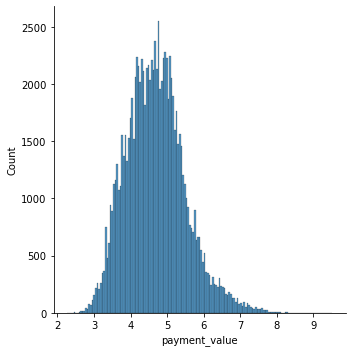

In [16]:
print(len(order_pay_unique))
sns.displot(np.log(order_pay_unique.payment_value))

In [17]:
order_pay_unique[order_pay_unique.payment_value == 0]

,order_id,payment_sequential,payment_installments,payment_value
251,00b1cb0320190ca0daa2c88b35206009,1,1,0.0
27282,4637ca194b6387e2d538dc89b124b0ee,1,1,0.0
78007,c8c528189310eaa44a745b8d9d26908b,1,1,0.0


## Orders review

In [18]:
order_rev.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [19]:
review_score = order_rev.groupby('order_id').agg({
                'review_score': 'mean'}).reset_index()
review_score

,order_id,review_score
0,00010242fe8c5a6d1ba2dd792cb16214,5.0
1,00018f77f2f0320c557190d7a144bdd3,4.0
2,000229ec398224ef6ca0657da4fc703e,5.0
3,00024acbcdf0a6daa1e931b038114c75,4.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,5.0
...,...,...
98668,fffc94f6ce00a00581880bf54a75a037,5.0
98669,fffcd46ef2263f404302a634eb57f7eb,5.0
98670,fffce4705a9662cd70adb13d4a31832d,5.0
98671,fffe18544ffabc95dfada21779c9644f,5.0


In [20]:
# looking at orders with more than one review
order_rev[order_rev.order_id == 'c88b1d1b157a9999ce368f218a407141']

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
1985,ffb8cff872a625632ac983eb1f88843c,c88b1d1b157a9999ce368f218a407141,3,NaN,NaN,2017-07-22 00:00:00,2017-07-26 13:41:07
82525,202b5f44d09cd3cfc0d6bd12f01b044c,c88b1d1b157a9999ce368f218a407141,5,NaN,NaN,2017-07-22 00:00:00,2017-07-26 13:40:22
89360,fb96ea2ef8cce1c888f4d45c8e22b793,c88b1d1b157a9999ce368f218a407141,5,NaN,NaN,2017-07-21 00:00:00,2017-07-26 13:45:15


## Product and sellers

In [21]:
products.profile_report()

Render HTML: 100%|██████████| 1/1 [00:02<00:00,  2.89s/it]


In [22]:
products = pd.merge(products, cat_trans, how='left')
products.columns

Index(['product_id', 'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english'],
      dtype='object')

In [23]:
sellers.columns

Index(['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_state'], dtype='object')

# Main data
Main features are going to be summarize in two tables:
1) Customers and order information
2) Sellers information

## Customers and orders information
Information on customers and orders are going to be summarized in a new dataframe

In [24]:
# getting customers information from customers data set
features = pd.DataFrame(customers[['customer_id',
                        'customer_unique_id', 'customer_city']])
# (4) geolocation, lat and long of cities for customers
features = pd.merge(features, geoloc_sum, how='left')
# (6) order_id and purchase
features = pd.merge(features, order_ds[['customer_id', 'order_id',
                                        'order_purchase_timestamp',
                                        'order_delivered_customer_date']],
                    how='left')
# (10) number of items per order
# review score
features = pd.merge(features, review_score[['order_id',
                    'review_score']], how='left')
# payment value per order
features = pd.merge(features, order_pay_unique[['order_id', 'payment_value']],
                    how='left')

features

,customer_id,customer_unique_id,customer_city,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,order_delivered_customer_date,review_score,payment_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,franca,-20.534057,-47.398437,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2017-05-25 10:35:35,4.0,146.87
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,sao bernardo do campo,-23.707626,-46.563869,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,2018-01-29 12:41:19,5.0,335.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,sao paulo,-23.570860,-46.633242,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2018-06-14 17:58:51,5.0,157.73
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,mogi das cruzes,-23.530402,-46.193888,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2018-03-28 16:04:25,5.0,173.30
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,campinas,-22.900861,-47.068536,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,2018-08-09 20:55:48,5.0,252.25
...,...,...,...,...,...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,sao paulo,-23.570860,-46.633242,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2018-04-13 20:06:37,4.0,88.78
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,taboao da serra,-23.620738,-46.780156,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,2018-04-11 18:54:45,5.0,129.06
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,fortaleza,-3.763108,-38.532430,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,2018-05-09 19:03:15,1.0,56.04
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,canoas,-29.921656,-51.174495,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,2017-11-16 19:58:39,5.0,711.07


In [25]:
# (1) creating a df with information about products for each order
order_products = pd.merge(order_items, products[['product_id',
                          'product_category_name_english']], how='left')

order_items_group = order_products.groupby('order_id').agg({
                     'order_item_id': 'sum',
                     'price': 'sum',
                     'freight_value': 'sum',
                     'product_category_name_english':
                     lambda tdf: tdf.unique().tolist()})

order_items_group = order_items_group.reset_index()

# (14) create a new column with number of different categories per order
order_items_group['n_product_category'] = order_items_group.\
                                           product_category_name_english.\
                                           str.len()

# (19) rename column order_item_id
order_items_group = order_items_group.rename(columns={
                     'order_item_id': 'n_items',
                     'product_category_name_english': 'product_category'})
order_items_group

,order_id,n_items,price,freight_value,product_category,n_product_category
0,00010242fe8c5a6d1ba2dd792cb16214,1,58.90,13.29,[cool_stuff],1
1,00018f77f2f0320c557190d7a144bdd3,1,239.90,19.93,[pet_shop],1
2,000229ec398224ef6ca0657da4fc703e,1,199.00,17.87,[furniture_decor],1
3,00024acbcdf0a6daa1e931b038114c75,1,12.99,12.79,[perfumery],1
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,199.90,18.14,[garden_tools],1
...,...,...,...,...,...,...
98661,fffc94f6ce00a00581880bf54a75a037,1,299.99,43.41,[housewares],1
98662,fffcd46ef2263f404302a634eb57f7eb,1,350.00,36.53,[computers_accessories],1
98663,fffce4705a9662cd70adb13d4a31832d,1,99.90,16.95,[sports_leisure],1
98664,fffe18544ffabc95dfada21779c9644f,1,55.99,8.72,[computers_accessories],1


In [26]:
# merge product and n of items to features df
features = pd.merge(features, order_items_group, how='left')
features

,customer_id,customer_unique_id,customer_city,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,order_delivered_customer_date,review_score,payment_value,n_items,price,freight_value,product_category,n_product_category
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,franca,-20.534057,-47.398437,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2017-05-25 10:35:35,4.0,146.87,1.0,124.99,21.88,[office_furniture],1.0
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,sao bernardo do campo,-23.707626,-46.563869,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,2018-01-29 12:41:19,5.0,335.48,1.0,289.00,46.48,[housewares],1.0
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,sao paulo,-23.570860,-46.633242,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2018-06-14 17:58:51,5.0,157.73,1.0,139.94,17.79,[office_furniture],1.0
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,mogi das cruzes,-23.530402,-46.193888,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2018-03-28 16:04:25,5.0,173.30,1.0,149.94,23.36,[office_furniture],1.0
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,campinas,-22.900861,-47.068536,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,2018-08-09 20:55:48,5.0,252.25,1.0,230.00,22.25,[home_confort],1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,sao paulo,-23.570860,-46.633242,6760e20addcf0121e9d58f2f1ff14298,2018-04-07 15:48:17,2018-04-13 20:06:37,4.0,88.78,1.0,74.90,13.88,[books_general_interest],1.0
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,taboao da serra,-23.620738,-46.780156,9ec0c8947d973db4f4e8dcf1fbfa8f1b,2018-04-04 08:20:22,2018-04-11 18:54:45,5.0,129.06,1.0,114.90,14.16,[sports_leisure],1.0
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,fortaleza,-3.763108,-38.532430,fed4434add09a6f332ea398efd656a5c,2018-04-08 20:11:50,2018-05-09 19:03:15,1.0,56.04,1.0,37.00,19.04,[health_beauty],1.0
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,canoas,-29.921656,-51.174495,e31ec91cea1ecf97797787471f98a8c2,2017-11-03 21:08:33,2017-11-16 19:58:39,5.0,711.07,1.0,689.00,22.07,[watches_gifts],1.0


In [27]:
features.isna().sum()

customer_id                         0
customer_unique_id                  0
customer_city                       0
geolocation_lat                    66
geolocation_lng                    66
order_id                            0
order_purchase_timestamp            0
order_delivered_customer_date    2965
review_score                      768
payment_value                       1
n_items                           775
price                             775
freight_value                     775
product_category                  775
n_product_category                775
dtype: int64

In [28]:
features.customer_unique_id.nunique()

96096

## Table with sellers information

In [29]:
# (1) products and sellers
prod_sellers = pd.merge(order_items, sellers[[
                'seller_id', 'seller_city']], how='left')

# (2) rename geoloc_sum column
geoloc_sum = geoloc_sum.rename(columns={'customer_city': 'city'})
prod_sellers = prod_sellers.rename(columns={'seller_city': 'city'})

# (3) merge long-lat for seller
prod_sellers = pd.merge(prod_sellers, geoloc_sum, how='left')
prod_sellers


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,city,geolocation_lat,geolocation_lng
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,volta redonda,-22.508669,-44.097172
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,sao paulo,-23.570860,-46.633242
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,borda da mata,-22.262584,-46.171124
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,franca,-20.534057,-47.398437
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,loanda,-22.929384,-53.135873
...,...,...,...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41,itajai,-26.908682,-48.681900
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53,sao paulo,-23.570860,-46.633242
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95,curitiba,-25.453054,-49.274996
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72,sao paulo,-23.570860,-46.633242


# Data Analysis

## Evolution of orders in timeline

,date,price,n_items,n_purchase
0,2016-09-04,72.89,3.0,1
1,2016-09-05,59.50,1.0,1
2,2016-09-13,0.00,0.0,1
3,2016-09-15,134.97,6.0,1
4,2016-10-02,100.00,1.0,1
...,...,...,...,...
629,2018-09-29,0.00,0.0,1
630,2018-10-01,0.00,0.0,1
631,2018-10-03,0.00,0.0,1
632,2018-10-16,0.00,0.0,1


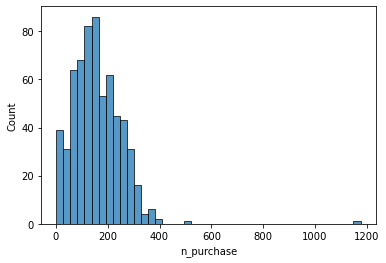

In [30]:
# getting date and price of purchase
date_price = pd.DataFrame()
aux = pd.to_datetime(features.order_purchase_timestamp).dt.date
date_price['date'] = aux
date_price['price'] = features.price
date_price['n_items'] = features.n_items

# Number of purchases per day and total amount
purchase_date_price = date_price.groupby('date').agg({
                       'price': 'sum', 'n_items': 'sum'}).reset_index()
purchase_date_price['n_purchase'] = purchase_date_price['date'].map(
                                     date_price['date'].
                                     value_counts())
sns.histplot(purchase_date_price.n_purchase)
purchase_date_price

In [31]:
# plot number of purchase per day and total ammount
fig2 = px.scatter(purchase_date_price, x='date', y='price',
                  size='n_purchase', color='n_items',
                  labels=dict(price='Total daily revenu', date='Date',
                              n_items='Number of items sells'),
                  title="Sells per day")

fig2.add_shape(type='line',
               x0=purchase_date_price.date.min(),
               y0=purchase_date_price.price.mean(),
               x1=purchase_date_price.date.max(),
               y1=purchase_date_price.price.mean())
fig2.show()

In [32]:
print('The mean daily revenu is:',
       purchase_date_price.price.mean())

2:8: E127 continuation line over-indented for visual indent


The mean daily revenu is: 21437.92381703471


In [33]:
# boxplot of daily revenu
fig3 = px.box(purchase_date_price, y='price',
              labels=dict(price='Total daily revenu',
                          title="Sells per day"))
fig3.update_layout(autosize=False,
                   width=500,
                   height=500)
fig3.show()

The figures above shows that from September 2016 to January 2017 and, from September 2018 to October 2018, there is less data.
On November 2017 there was pic of sells, it corresponds to Black Friday, this kind of event is considered as an outlier.
  
## Customers behaviour and review
The following figures will give a first look to:
- how much each customer spends for the period of data that we are analysing;
- the mean score review given for each of them;
- geolocalisation of best customers.

In [81]:
# group scores and expenses per client

customers_freq = pd.DataFrame()
customers_freq['customer_id'] = features.customer_unique_id
customers_freq['freq'] = 1
customers_freq['mean_score'] = features.review_score
customers_freq['total_buy'] = features.price

# group by to use mean scores and quantify buyings

customers_freq = customers_freq.groupby('customer_id').agg({
                 'freq': 'sum', 'mean_score': 'mean', 'total_buy': 'sum'})
customers_freq = customers_freq.reset_index()
customers_freq.sort_values(by=['freq', 'total_buy'], ascending=False)

,customer_id,freq,mean_score,total_buy
52973,8d50f5eadf50201ccdcedfb9e2ac8455,17,4.764706,729.62
23472,3e43e6105506432c953e165fb2acf44c,9,2.777778,1000.85
10354,1b6c7548a2a1f9037c1fd3ddfed95f33,7,5.000000,809.21
76082,ca77025e7201e3b30c44b472ff346268,7,5.000000,806.61
37797,6469f99c1f9dfae7733b25662e7f1782,7,5.000000,664.20
...,...,...,...,...
95593,feb643dc81ca576d83810f147e0e089c,1,1.000000,0.00
95612,fec36733d170d71e390acde47d74c6d6,1,2.000000,0.00
95754,ff222edf83338ca6b35f8e29871fa07a,1,1.000000,0.00
95765,ff28720521c749234b1ba19c9c986f4c,1,1.000000,0.00


In [91]:
fig4 = px.scatter(customers_freq, x=customers_freq.index,
                  y='total_buy', color='mean_score', size='freq',
                  labels=dict(total_buy='Money expend for customer',
                              index='Client'),
                  title="Expenses-frequency and mean review per customer")

fig4.add_shape(type='line',
               x0=customers_freq.index.min(),
               y0=customers_freq.total_buy.mean(),
               x1=customers_freq.index.max(),
               y1=customers_freq.total_buy.mean())
fig4.show()

1:58: W291 trailing whitespace


<AxesSubplot:xlabel='total_buy', ylabel='Count'>

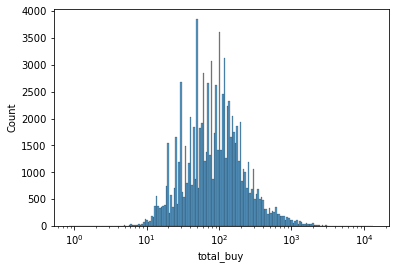

In [123]:
customers_freq_cut = customers_freq[(customers_freq.total_buy != 0) &
                                    (customers_freq.total_buy.notna())]
fig5 = sns.histplot(data=customers_freq_cut, x='total_buy', log_scale=True)
fig5


In [35]:
review_expenses = features.groupby('order_id').agg({
                  'review_score': 'mean', 'n_items': 'mean'}).reset_index()
purchase_date_price['n_purchase'] = purchase_date_price['date'].map(
                                     date_price['date'].
                                     value_counts())
purchase_date_price

,date,price,n_items,n_purchase
0,2016-09-04,72.89,3.0,1
1,2016-09-05,59.50,1.0,1
2,2016-09-13,0.00,0.0,1
3,2016-09-15,134.97,6.0,1
4,2016-10-02,100.00,1.0,1
...,...,...,...,...
629,2018-09-29,0.00,0.0,1
630,2018-10-01,0.00,0.0,1
631,2018-10-03,0.00,0.0,1
632,2018-10-16,0.00,0.0,1


In [36]:
reviews = features.review_score

print('Missing reviews:', reviews.isna().sum(),
      '\nTotal Orders:', len(reviews))
fig4 = px.histogram(y=reviews, labels=dict(
                    y='Score review',
                    title="Scores from clients"))
fig4.update_layout(autosize=False,
                   width=800,
                   height=500)
fig4.show()

Missing reviews: 768 
Total Orders: 99441


#### Clients geolocalisation

In [44]:
# Clients geolalisation
geo = features[['customer_city', 'geolocation_lat', 'geolocation_lng']]
geo = geo.groupby(['customer_city', 'geolocation_lat',
                  'geolocation_lng']).size().reset_index(name='n_purchase')

In [72]:
import folium

m1 = folium.Map(location=[-14.242914500000001,-53.1892665], zoom_start=5)

for i in range(0,len(geo)):
   folium.Circle(
      location=[geo.iloc[i]['geolocation_lat'], geo.iloc[i]['geolocation_lng']],
      popup=str(geo.iloc[i]['customer_city']) + ',' + str(geo.iloc[i]['n_purchase']),
      radius=float(geo.iloc[i]['n_purchase'])*10,
      color='crimson',
      fill=True,
      fill_color='crimson'
   ).add_to(m1)

m1

1:45: E231 missing whitespace after ','
3:17: E231 missing whitespace after ','
4:4: E111 indentation is not a multiple of 4
5:80: E501 line too long (80 > 79 characters)
6:80: E501 line too long (85 > 79 characters)


In [79]:

geo50 = geo.nlargest(50, 'n_purchase')
geo50 = geo50.reset_index(drop=True)

m2 = folium.Map(location=[-14.242914500000001,-53.1892665], zoom_start=5)

for i in range(0,len(geo50)):
   folium.Circle(
      location=[geo50.iloc[i]['geolocation_lat'], geo50.iloc[i]['geolocation_lng']],
      popup=str(geo50.iloc[i]['customer_city']) + ',' + str(geo50.iloc[i]['n_purchase']),
      radius=float(geo50.iloc[i]['n_purchase'])*20,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   ).add_to(m2)

m2

5:46: E231 missing whitespace after ','
7:17: E231 missing whitespace after ','
8:4: E111 indentation is not a multiple of 4
9:80: E501 line too long (84 > 79 characters)
10:80: E501 line too long (89 > 79 characters)


# Feature engenieering 
In this section the features for the clients segmentation are going to be build.
Data from 01/2017 to 08/2018 is going be selected